In [1]:
from ultralytics import YOLO
from utils import *
import cv2
import os

In [2]:
YOLO_MODEL_NAME = 'models/yolov8n.pt'

IMAGE_LIST = [
    "image/grp-3.jpg",
    "image/image.png",
    "image/group.jpg",
    "image/grp-photo.jpg",
    "image/fig-5.jpg",
    "image/Fig 6..jpg",   
    "image/Fig 8.jpg" 
]

model = YOLO(YOLO_MODEL_NAME)
print(f"Model loaded: {YOLO_MODEL_NAME}")

Model loaded: models/yolov8n.pt



📌 Processing image: image/grp-3.jpg
Detections: 3, Min confidence: 0.75
Detections: 3, Min confidence: 0.81
Detections: 2, Min confidence: 0.62


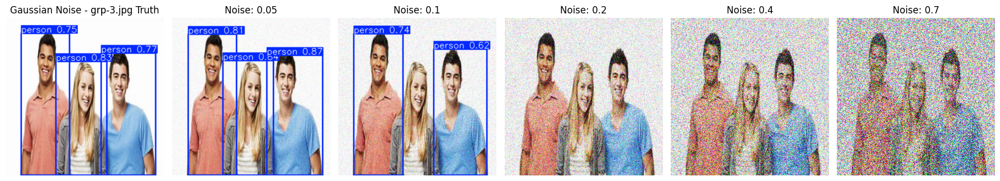

Detections: 3, Min confidence: 0.75
Detections: 2, Min confidence: 0.70
Detections: 1, Min confidence: 0.68
Detections: 2, Min confidence: 0.54


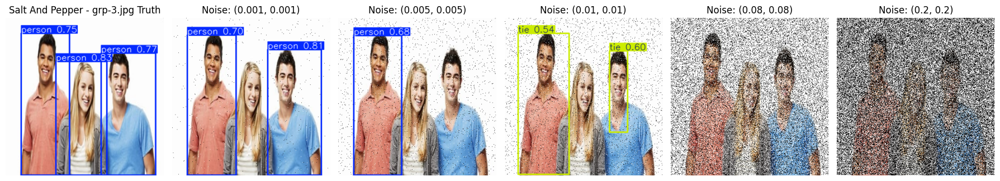

Detections: 3, Min confidence: 0.68
Detections: 3, Min confidence: 0.72
Detections: 3, Min confidence: 0.70
Detections: 3, Min confidence: 0.66
Detections: 1, Min confidence: 0.71


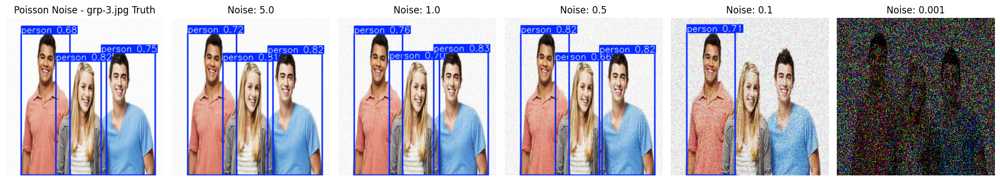


📌 Processing image: image/image.png
Detections: 4, Min confidence: 0.77
Detections: 4, Min confidence: 0.68
Detections: 4, Min confidence: 0.59


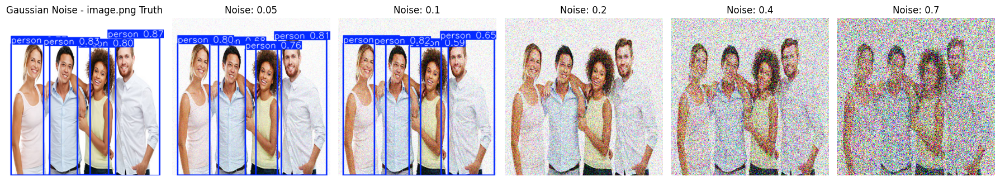

Detections: 4, Min confidence: 0.77
Detections: 4, Min confidence: 0.72
Detections: 4, Min confidence: 0.64
Detections: 1, Min confidence: 0.58
Detections: 1, Min confidence: 0.54


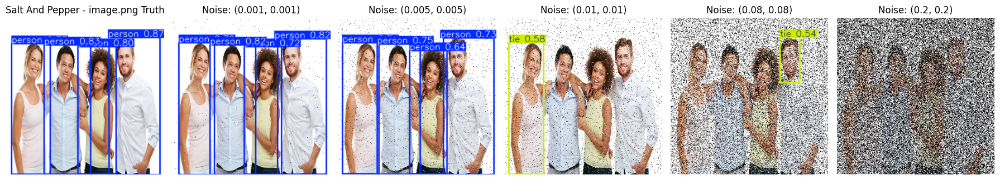

Detections: 4, Min confidence: 0.76
Detections: 4, Min confidence: 0.77
Detections: 4, Min confidence: 0.76
Detections: 4, Min confidence: 0.70
Detections: 2, Min confidence: 0.61


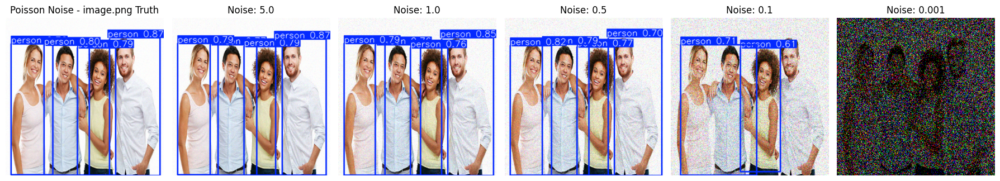


📌 Processing image: image/group.jpg
Detections: 5, Min confidence: 0.55
Detections: 7, Min confidence: 0.55
Detections: 4, Min confidence: 0.58


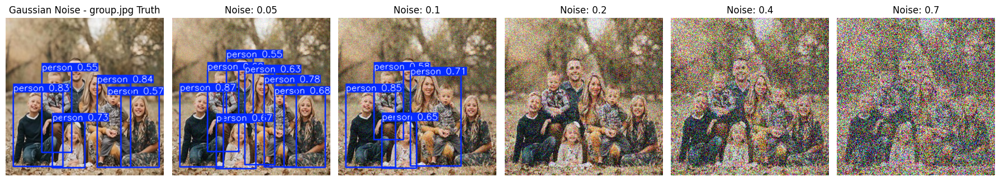

Detections: 5, Min confidence: 0.55
Detections: 7, Min confidence: 0.52
Detections: 4, Min confidence: 0.67
Detections: 2, Min confidence: 0.61


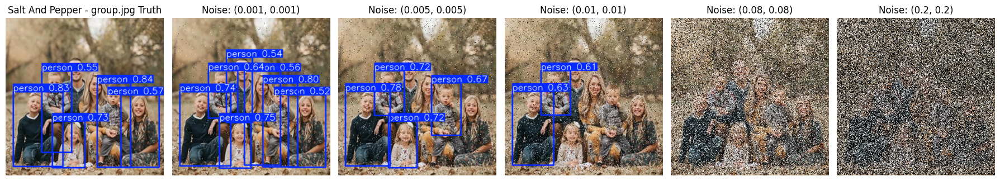

Detections: 5, Min confidence: 0.62
Detections: 6, Min confidence: 0.60
Detections: 6, Min confidence: 0.58
Detections: 7, Min confidence: 0.50
Detections: 2, Min confidence: 0.60


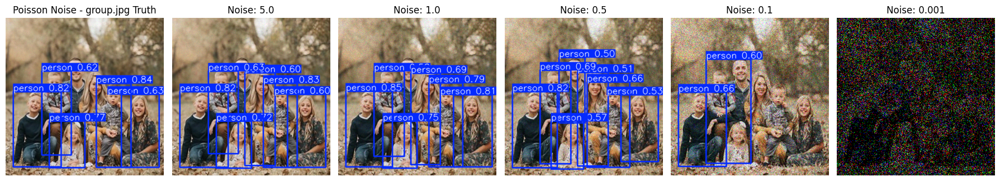


📌 Processing image: image/grp-photo.jpg
Detections: 11, Min confidence: 0.51
Detections: 8, Min confidence: 0.56
Detections: 1, Min confidence: 0.50


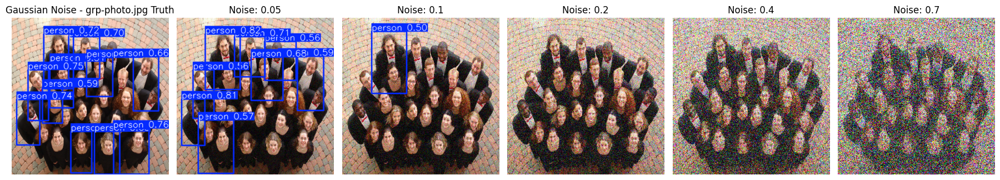

Detections: 11, Min confidence: 0.51
Detections: 11, Min confidence: 0.52
Detections: 7, Min confidence: 0.56
Detections: 1, Min confidence: 0.67


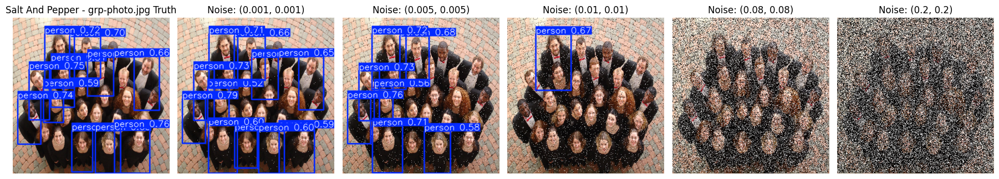

Detections: 10, Min confidence: 0.57
Detections: 10, Min confidence: 0.51
Detections: 6, Min confidence: 0.54
Detections: 2, Min confidence: 0.68
Detections: 1, Min confidence: 0.60


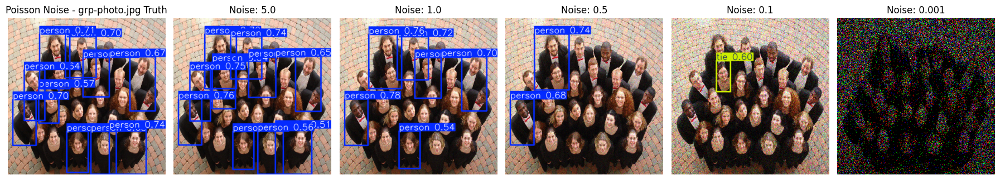


📌 Processing image: image/fig-5.jpg
Detections: 4, Min confidence: 0.85
Detections: 4, Min confidence: 0.84
Detections: 4, Min confidence: 0.80
Detections: 1, Min confidence: 0.53


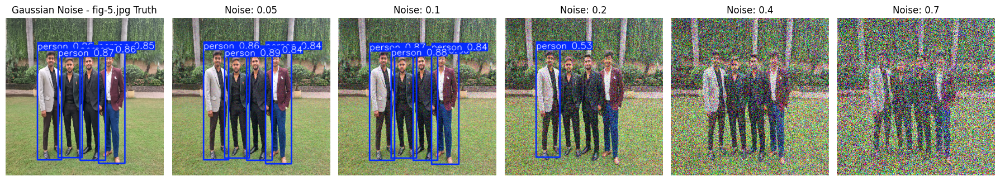

Detections: 4, Min confidence: 0.85
Detections: 4, Min confidence: 0.85
Detections: 4, Min confidence: 0.85
Detections: 4, Min confidence: 0.78
Detections: 2, Min confidence: 0.50


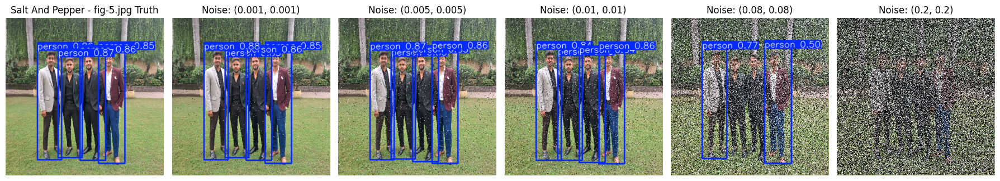

Detections: 4, Min confidence: 0.85
Detections: 4, Min confidence: 0.84
Detections: 4, Min confidence: 0.84
Detections: 4, Min confidence: 0.83
Detections: 4, Min confidence: 0.79


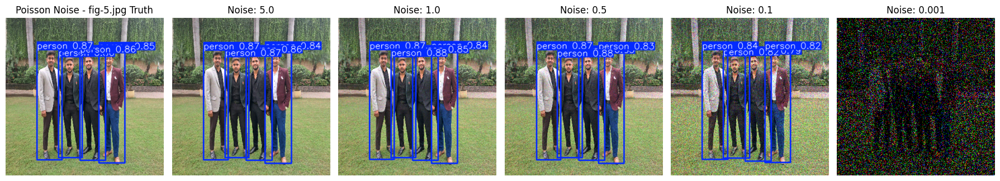


📌 Processing image: image/Fig 6..jpg
Detections: 6, Min confidence: 0.63
Detections: 4, Min confidence: 0.69
Detections: 2, Min confidence: 0.51


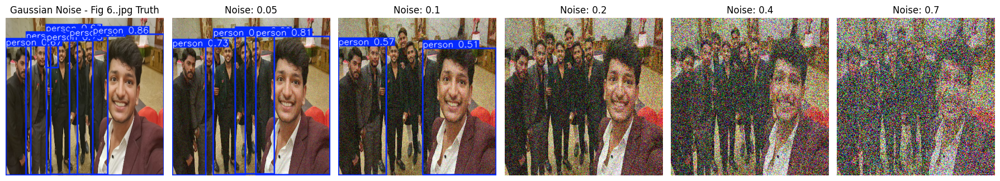

Detections: 6, Min confidence: 0.63
Detections: 6, Min confidence: 0.52
Detections: 1, Min confidence: 0.62


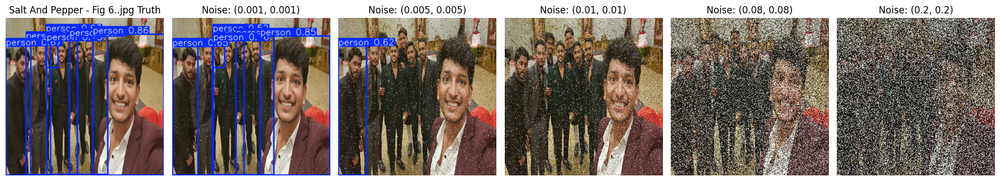

Detections: 7, Min confidence: 0.53
Detections: 6, Min confidence: 0.58
Detections: 5, Min confidence: 0.52
Detections: 4, Min confidence: 0.69


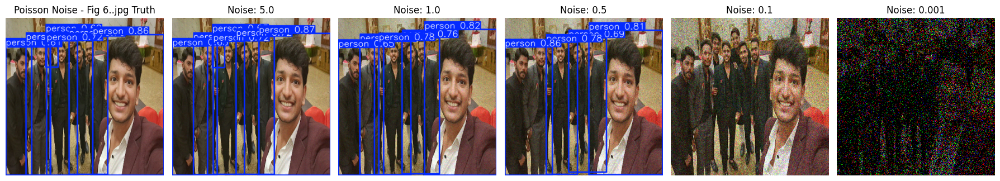


📌 Processing image: image/Fig 8.jpg
Detections: 2, Min confidence: 0.59
Detections: 2, Min confidence: 0.75
Detections: 2, Min confidence: 0.54


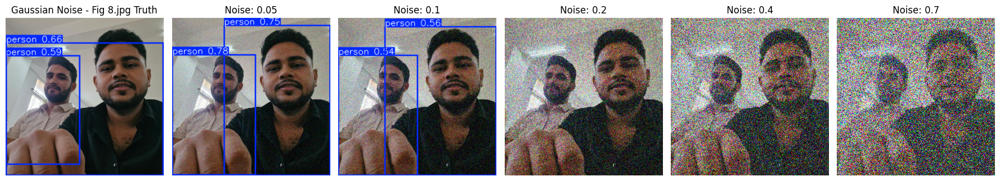

Detections: 2, Min confidence: 0.59
Detections: 1, Min confidence: 0.78
Detections: 1, Min confidence: 0.51
Detections: 1, Min confidence: 0.55


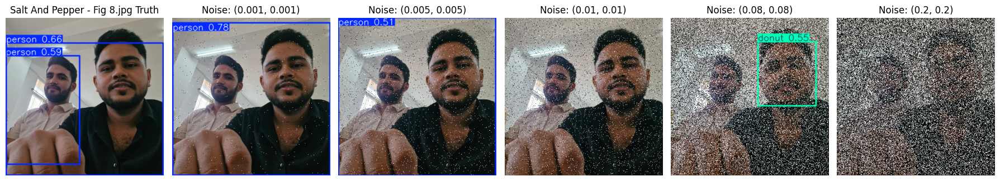

Detections: 2, Min confidence: 0.62
Detections: 2, Min confidence: 0.60
Detections: 2, Min confidence: 0.69
Detections: 2, Min confidence: 0.66


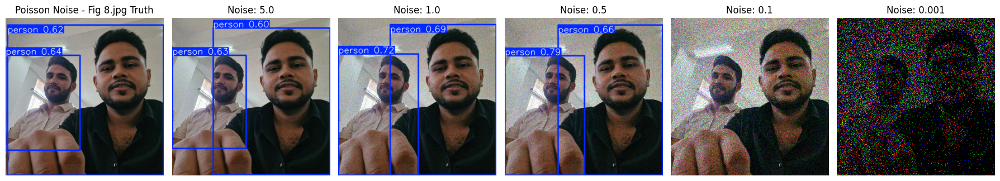

In [4]:
from utils import _show, read_image, add_gaussian_noise, add_salt_and_pepper_noise, add_poisson_noise, draw_yolo_boxes

# Noise parameters (same as robustness evaluation)
SIGMA = [0.0, 0.05, 0.1, 0.2, 0.4, 0.7]

SALT_PEPPER = [
    (0.0,0.0),
    (0.001,0.001),
    (0.005,0.005),
    (0.01,0.01),
    (0.08,0.08),
    (0.2,0.2)
]

POISSION_LAMBDA = [10.0, 5.0, 1.0, 0.5, 0.1, 0.001]


def pipeline(model, image_path, noise_type, values):
    image = read_image(image_path)
    
    # Apply noise
    if noise_type == 'gaussian_noise':
        noisy_images = [add_gaussian_noise(image, sigma=s) for s in values]

    elif noise_type == 'salt_and_pepper':
        noisy_images = [
            add_salt_and_pepper_noise(image, salt_prob=p[0], pepper_prob=p[1]) 
            for p in values
        ]

    elif noise_type == 'poisson_noise':
        noisy_images = [add_poisson_noise(image, intensity=i) for i in values]

    else:
        raise ValueError("❌ Unsupported noise type")
    
    # Predict on noisy images
    predictions = [model.predict(img, save=False, verbose=False, conf=0.5) for img in noisy_images]

    # Draw bounding boxes
    annotated_images = [draw_yolo_boxes(pred, img) for pred, img in zip(predictions, noisy_images)]
    
    # Display results
    _show(values, annotated_images, f"{noise_type.replace('_',' ').title()} - {os.path.basename(image_path)}")


# ✅ Run pipeline for each test image
for img_path in IMAGE_LIST:
    print(f"\n📌 Processing image: {img_path}")
    
    pipeline(model, img_path, 'gaussian_noise', SIGMA)
    pipeline(model, img_path, 'salt_and_pepper', SALT_PEPPER)
    pipeline(model, img_path, 'poisson_noise', POISSION_LAMBDA)


In [27]:
import os, torch
from ultralytics.utils.metrics import box_iou
from ultralytics import YOLO
import numpy as np
from utils import _show, read_image, add_gaussian_noise, add_salt_and_pepper_noise, add_poisson_noise, draw_yolo_boxes

# ---- GT counts for your images ----
GT_COUNT = {
    "grp-1.jpg": 3,
    "grp-2.jpg": 4,
    "grp-3.jpg": 7,
    "grp-4.jpg": 15
}

IOU_THRESHOLD = 0.3

def compute_metrics(pred, gt_count):
    if len(pred[0].boxes) == 0:
        return 0, 0, 0

    pred_boxes = pred[0].boxes.xyxy.cpu()
    det = len(pred_boxes)

    # Dummy GT boxes for IoU (we only have GT count)
    gt = torch.zeros((gt_count, 4))  
    if gt_count == 0:  
        return det, 0, 0

    iou = box_iou(pred_boxes, gt)
    max_iou = iou.max(1).values
    matched = (max_iou > IOU_THRESHOLD).sum().item()

    recall = matched / gt_count
    mean_iou = float(max_iou.mean())
    return det, recall, mean_iou


def pipeline(model, image_path, noise_type, values):
    image = read_image(image_path)
    file = os.path.basename(image_path)
    gt = GT_COUNT[file]

    records = []   # store (noise, det, recall, IoU)

    if noise_type == 'gaussian_noise':
        noisy_images = [add_gaussian_noise(image, sigma=s) for s in values]
    elif noise_type == 'salt_and_pepper':
        noisy_images = [add_salt_and_pepper_noise(image, salt_prob=p[0], pepper_prob=p[1]) for p in values]
    elif noise_type == 'poisson_noise':
        noisy_images = [add_poisson_noise(image, intensity=i) for i in values]
    else:
        raise ValueError("Unsupported noise type")
    
    predictions = [model.predict(img, save=False, verbose=False, conf=0.5) for img in noisy_images]
    annotated_images = [draw_yolo_boxes(pred, img) for pred, img in zip(predictions, noisy_images)]

    # ✅ Collect robustness data
    for val, pred in zip(values, predictions):
        det, rec, iou = compute_metrics(pred, gt)
        records.append((val, det, rec, iou))

    # Display detections
    _show(values, annotated_images, f"{noise_type.replace('_',' ').title()} - {file}")

    return records


# ---- Noise parameters ----
SIGMA = [0.0, 0.02, 0.05, 0.1, 0.2, 0.4]
SALT_PEPPER = [(0.0,0.0),(0.001,0.001),(0.005,0.005),(0.01,0.01),(0.03,0.03),(0.08,0.08)]
POISSION_LAMBDA = [10.0, 5.0, 1.0, 0.5, 0.1, 0.005]

IMAGE_LIST = ["image/grp-1.jpg","image/grp-2.jpg","image/grp-3.jpg","image/grp-4.jpg"]

model = YOLO("yolov8n.pt")

# ---- Run + print robustness metrics ----
for img in IMAGE_LIST:
    print(f"\n📌 Results for: {os.path.basename(img)}")

    results = []
    for noise_type, values in [
        ("gaussian_noise",SIGMA),
        ("salt_and_pepper",SALT_PEPPER),
        ("poisson_noise",POISSION_LAMBDA)
    ]:
        rec = pipeline(model, img, noise_type, values)

        print(f"\n🔸 {noise_type.upper()} Results:")
        print("Noise\tDet\tRecall\tIoU")
        for r in rec:
            print(f"{r[0]}\t{r[1]}\t{round(r[2],3)}\t{round(r[3],3)}")



📌 Results for: grp-1.jpg


FileNotFoundError: Image not found: image/grp-1.jpg